In [26]:
import numpy as np
import healpy as hp
import myfuncs as mf
import orphics.maps
from pixell import enmap, curvedsky as cs, utils, lensing as pixlens, enplot
from matplotlib import pyplot as plt
import matplotlib as mpl
from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats('svg')

# Inputs

## Read in Sims

In [28]:
kappa_sim_ID = 352

In [29]:
frank_kappa_name = f'/home/r/rbond/jiaqu/DR6lensing_backup/DR6lensing/full_mask/output/release_sims/kappaMV_{kappa_sim_ID}_alms.fits'
frank_kappa = np.cdouble(hp.read_alm(frank_kappa_name))

In [70]:
frank_nonoise_name = '/home/r/rbond/jiaqu/scratch/DR6/maps/sims/coaddv3/kcoadd_fullres_coadd_alm_set01_00190.fits'
frank_nonoise = np.cdouble(hp.read_alm(frank_nonoise_name))

In [30]:
alex_phi_name = f'/scratch/r/rbond/msyriac/data/sims/alex/v0.4/fullskyPhi_alm_00{kappa_sim_ID}.fits'
alex_phi = np.cdouble(hp.read_alm(alex_phi_name))
alex_kappa = pixlens.phi_to_kappa(alex_phi)

In [46]:
alex_cmb_name1 = '/scratch/r/rbond/msyriac/data/sims/alex/v0.4/fullskyLensedUnabberatedCMB_alm_set00_00001.fits'
alex_cmb_set1 = orphics.maps.change_alm_lmax(np.cdouble(hp.read_alm(alex_cmb_name1, hdu=(1,2,3))), LMAX)

In [94]:
alex_cmb_name2 = '/scratch/r/rbond/msyriac/data/sims/alex/v0.4/fullskyLensedUnabberatedCMB_alm_set01_00001.fits'
alex_cmb_set2 = orphics.maps.change_alm_lmax(np.cdouble(hp.read_alm(alex_cmb_name2, hdu=(1,2,3))), LMAX)

In [95]:
hp.read_alm(alex_cmb_name2, hdu=(1,2,3))[0][:3]

array([-0.08548952+0.j, -0.14964625+0.j, 41.19802   +0.j], dtype=complex64)

In [96]:
hp.read_alm(alex_cmb_name1, hdu=(1,2,3))[0][:3]

array([ 2.1840056e-02+0.j, -1.2920119e-02+0.j, -2.5896338e+01+0.j],
      dtype=complex64)

In [78]:
avg_Cl_set0 = np.zeros(ells.shape)
simrange = range(10, 99)

for i in simrange:
    alex_cmb_name = '/scratch/r/rbond/msyriac/data/sims/alex/v0.4/fullskyLensedUnabberatedCMB_alm_set00_000' + str(i) + '.fits'
    alex_cmb = np.cdouble(hp.read_alm(alex_cmb_name))
    
    sim_Cl = hp.alm2cl(alex_cmb, lmax=LMAX)
    avg_Cl_set0 += sim_Cl

avg_Cl_set0 /= len(simrange)

In [79]:
avg_Cl_set1 = np.zeros(ells.shape)
simrange = range(10, 99)

for i in simrange:
    alex_cmb_name = '/scratch/r/rbond/msyriac/data/sims/alex/v0.4/fullskyLensedUnabberatedCMB_alm_set01_000' + str(i) + '.fits'
    alex_cmb = np.cdouble(hp.read_alm(alex_cmb_name))
    
    sim_Cl = hp.alm2cl(alex_cmb, lmax=LMAX)
    avg_Cl_set1 += sim_Cl

avg_Cl_set1 /= len(simrange)

In [109]:
# sim_alm = alex_cmb
# sim_alm = alex_kappa
sim_alm = frank_kappa

## Get Mask

In [30]:
mask_name = '/project/r/rbond/ymehta3/kmask_release.fits'
mask_map_old = enmap.read_map(mask_name)

In [5]:
mask_name = '/home/r/rbond/jiaqu/scratch/DR6/maps/sims/map_masks/BN_bottomcutsmooth1.fits'
mask_map_ancient = enmap.read_map(mask_name)

In [6]:
mask_name = '/home/r/rbond/jiaqu/scratch/DR6/downgrade/downgrade/act_mask_20220316_GAL060_rms_70.00_d2.fits'
mask_map_analysis_old = enmap.read_map(mask_name)

In [10]:
mask_name = '/home/r/rbond/jiaqu/scratch/DR6/downgrade/downgrade/act_mask_20220316_GAL060_rms_70.00_d2sk.fits'
mask_map_analysis = enmap.read_map(mask_name)

## Maps

Full sky

In [22]:
fs_shape, fs_wcs = enmap.fullsky_geometry(res=utils.arcmin)
footprint = enmap.zeros(fs_shape, fs_wcs)

DR6 Footprint

In [11]:
footprint = enmap.zeros(mask_map_analysis.shape, wcs=mask_map_analysis.wcs)

### Frank Maps

Noisy map

In [31]:
frank_kappa_map = cs.alm2map(np.nan_to_num(frank_kappa), footprint, tweak=True)

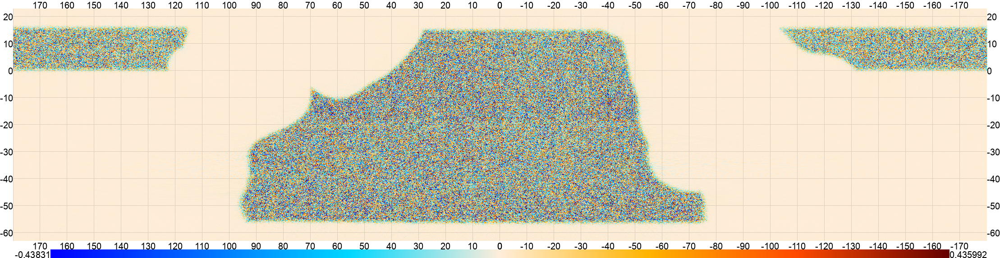

In [13]:
mf.eshow(frank_kappa_map)

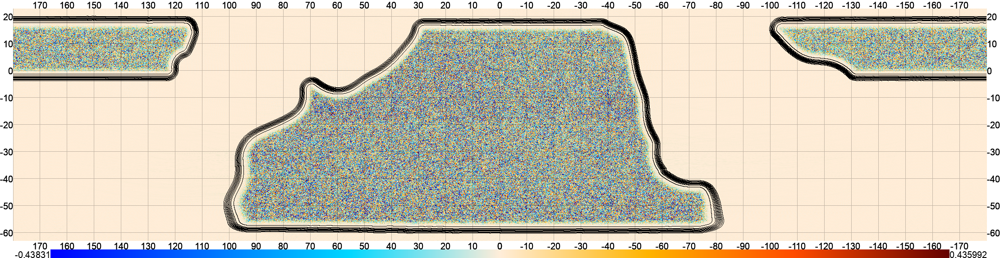

In [20]:
frank = enplot.get_plots(frank_kappa_map, ticks = 10, downgrade=10, colorbar=True)
mask_analysis = enplot.get_plots(mask_map_analysis, ticks = 10, downgrade=10, colorbar=False, no_image=True, contours=0.1)
big = enplot.merge_plots(frank + mask_analysis)
enplot.show(big)
# mf.eshow([mask_map_old, frank_kappa_map], combine=True, colorbar=False)

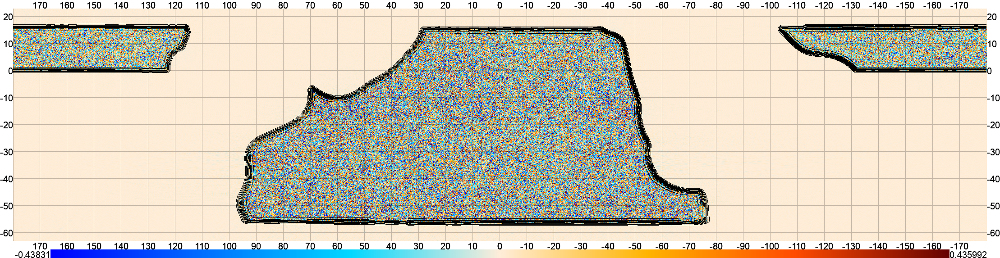

In [14]:
frank = enplot.get_plots(frank_kappa_map, ticks = 10, downgrade=10, colorbar=True)
mask_analysis = enplot.get_plots(mask_map_analysis, ticks = 10, downgrade=10, colorbar=False, no_image=True, contours=0.1)
big = enplot.merge_plots(frank + mask_analysis)
enplot.show(big)
# mf.eshow([mask_map_old, frank_kappa_map], combine=True, colorbar=False)

Noise-less map

In [71]:
frank_nonoise_map = cs.alm2map(np.nan_to_num(frank_nonoise), footprint, tweak=True)

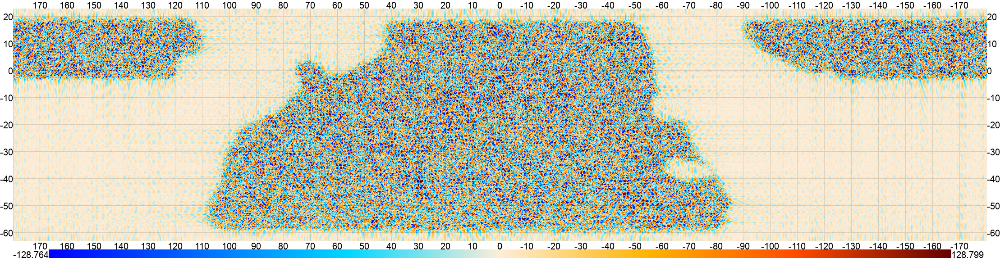

In [72]:
mf.eshow(frank_nonoise_map)

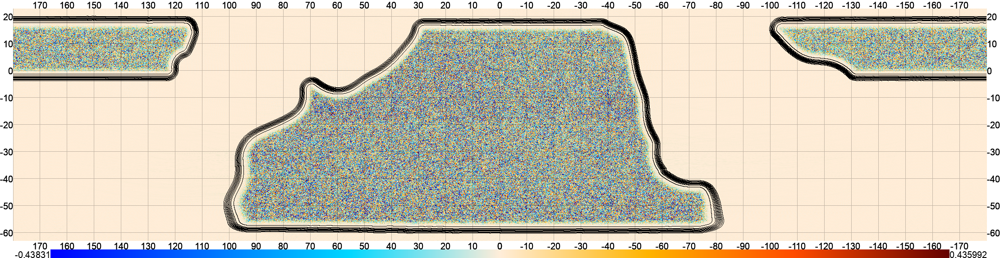

In [20]:
frank = enplot.get_plots(frank_kappa_map, ticks = 10, downgrade=10, colorbar=True)
mask_analysis = enplot.get_plots(mask_map_analysis, ticks = 10, downgrade=10, colorbar=False, no_image=True, contours=0.1)
big = enplot.merge_plots(frank + mask_analysis)
enplot.show(big)
# mf.eshow([mask_map_old, frank_kappa_map], combine=True, colorbar=False)

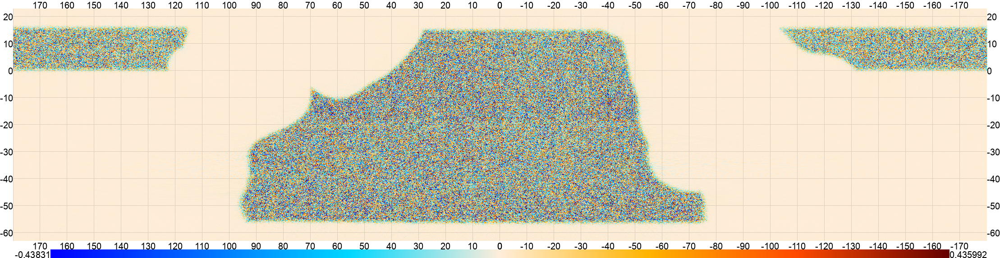

In [13]:
mf.eshow(frank_kappa_map)

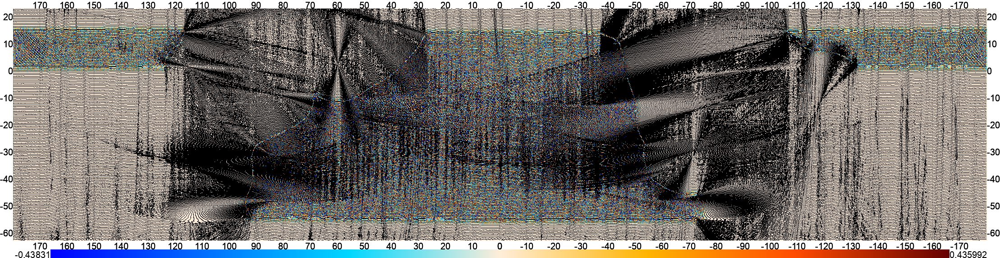

In [31]:
frank = enplot.get_plots(frank_kappa_map, ticks = 10, downgrade=10, colorbar=True)
mask = enplot.get_plots(mask_map_old, ticks = 10, downgrade=10, colorbar=False, no_image=True, contours=1)
big = enplot.merge_plots(frank+mask)
enplot.show(big)
# mf.eshow([mask_map_old, frank_kappa_map], combine=True, colorbar=False)

### Alex Sims

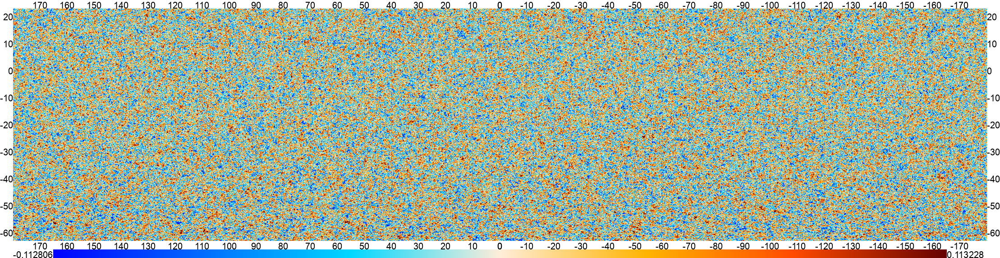

In [32]:
alex_kappa_map = cs.alm2map(alex_kappa, footprint, tweak=True)
mf.eshow(alex_kappa_map)

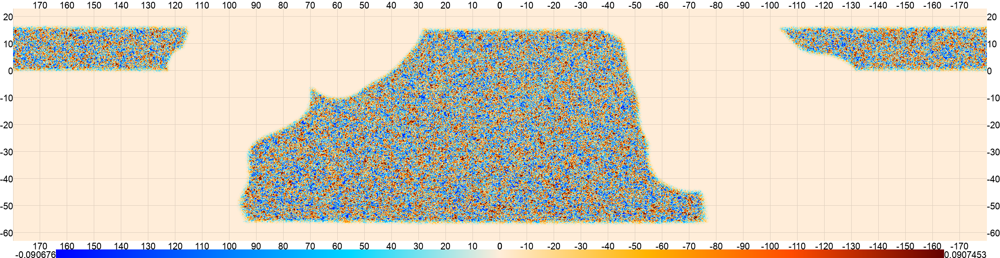

In [33]:
mf.eshow(alex_kappa_map * mask_map_analysis**2)

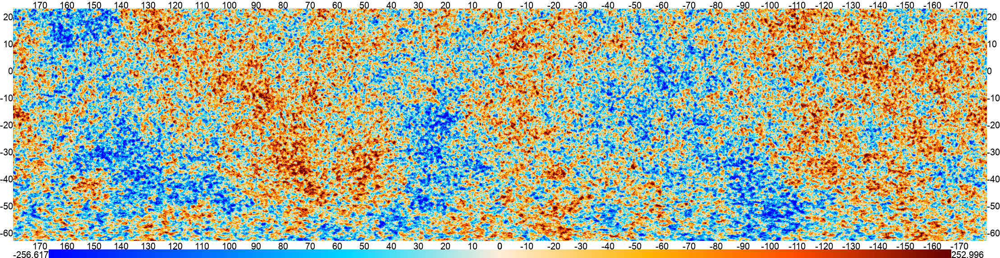

In [79]:
alex_TT_set1_map = cs.alm2map(alex_cmb_set1[0,:], footprint, tweak=True)
mf.eshow(alex_TT_set1_map)

### Masks

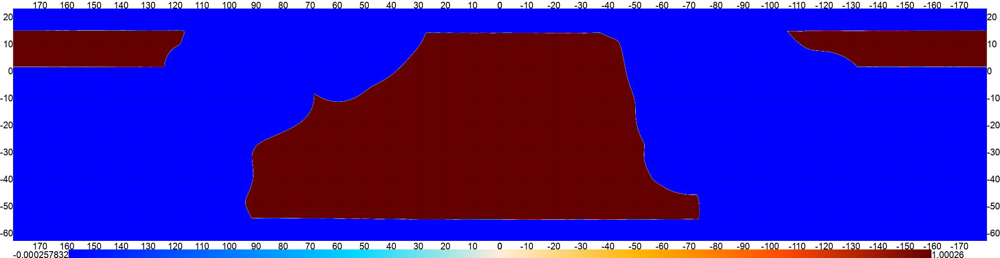

In [24]:
mf.eshow(mask_map_old)

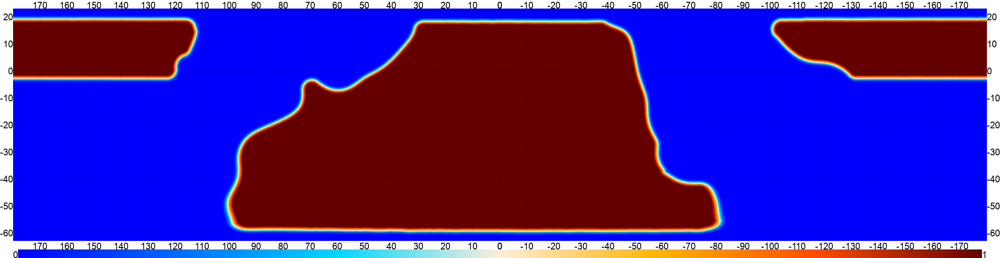

In [24]:
mf.eshow(np.real(mask_map_analysis))

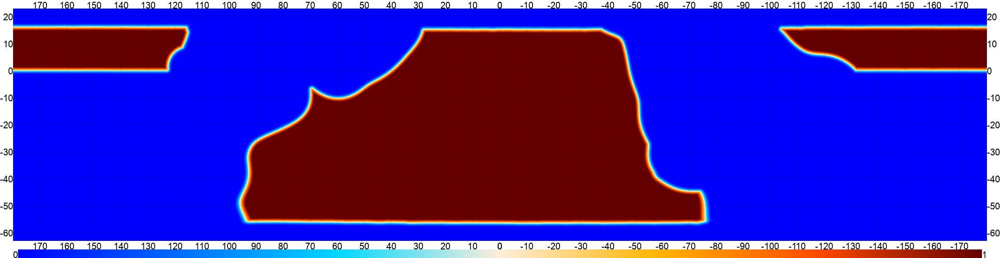

In [25]:
mf.eshow(np.real(mask_map_gerrit))

In [26]:
mf.wn(mask_map_gerrit, 1)

0.23389142943955665

In [27]:
mf.wn(mask_map_analysis, 1)

0.28198403151273516

In [28]:
mf.wn(mask_map_old, 1)

0.21347719091558248

## Power Spectra

In [6]:
LMAX = 4000
ells = np.arange(LMAX+1)
lfac = ells * (ells+1) / (2*np.pi)

In [105]:
sim_Cl = hp.alm2cl(sim_alm, lmax=LMAX)
sim_Dl = sim_Cl * lfac

### Alex's Kappa Sims

In [18]:
olmax = hp.Alm.getlmax(len(frank_kappa))
ells = np.arange(LMAX+1)

In [24]:
w2 = orphics.maps.wfactor(2, mask_map_analysis)
w3 = orphics.maps.wfactor(3, mask_map_analysis)
w4 = orphics.maps.wfactor(4, mask_map_analysis)

In [34]:
alex_kappa_masked = cs.map2alm(alex_kappa_map * mask_map_analysis**2, lmax=olmax, tweak=True)

num = hp.alm2cl(frank_kappa, alms2=alex_kappa_masked, lmax=olmax)
denom = hp.alm2cl(alex_kappa_masked, lmax=olmax)

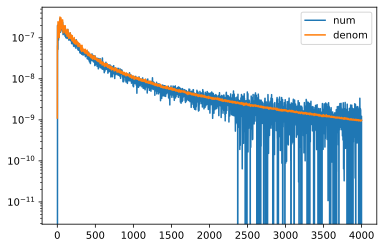

In [35]:
plt.plot(ells, num / w4, label='num')
plt.plot(ells, denom / w4, label='denom')
plt.legend()
plt.yscale('log');

### Alex's CMB Sims

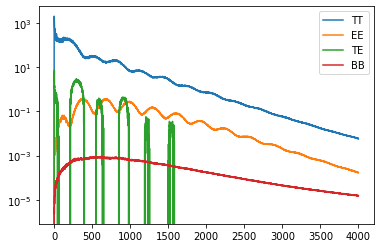

In [97]:
lmax = 4000

alex_TT_set1 = hp.alm2cl(alex_cmb_set1[0, :], lmax=LMAX)
alex_EE_set1 = hp.alm2cl(alex_cmb_set1[1, :], lmax=LMAX)
alex_TE_set1 = hp.alm2cl(alex_cmb_set1[1, :], alms2=alex_cmb_set1[0, :], lmax=LMAX)
alex_BB_set1 = hp.alm2cl(alex_cmb_set1[2, :], lmax=LMAX)

plt.plot(ells, ells*alex_TT_set1, label='TT')
plt.plot(ells, ells*alex_EE_set1, label='EE')
plt.plot(ells, ells*alex_TE_set1, label='TE')
plt.plot(ells, ells*alex_BB_set1, label='BB')

plt.yscale('log')
plt.legend();

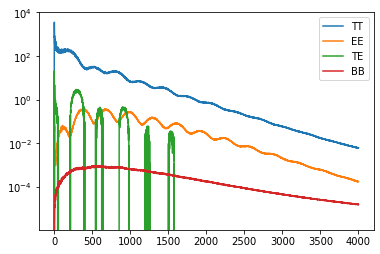

In [98]:
lmax = 4000

alex_TT_set2 = hp.alm2cl(alex_cmb_set2[0, :], lmax=LMAX)
alex_EE_set2 = hp.alm2cl(alex_cmb_set2[1, :], lmax=LMAX)
alex_TE_set2 = hp.alm2cl(alex_cmb_set2[1, :], alms2=alex_cmb_set2[0, :], lmax=LMAX)
alex_BB_set2 = hp.alm2cl(alex_cmb_set2[2, :], lmax=LMAX)

plt.plot(ells, ells*alex_TT_set2, label='TT')
plt.plot(ells, ells*alex_EE_set2, label='EE')
plt.plot(ells, ells*alex_TE_set2, label='TE')
plt.plot(ells, ells*alex_BB_set2, label='BB')

plt.yscale('log')
plt.legend();

Set 00 vs Set 01

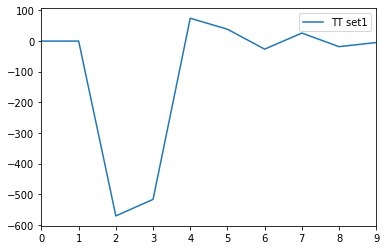

In [101]:
lmax = 4000

alex_TT_set2 = hp.alm2cl(alex_cmb_set2[0, :], lmax=LMAX)

plt.plot(ells, alex_TT_set1 - alex_TT_set2, label='TT set1')

plt.xlim(0,9)
plt.legend();

In [68]:
alex_TT_set1 == alex_TT_set2

array([ True,  True,  True, ...,  True,  True,  True])

### Myfuncs vs healpy

In [80]:
frank_kappa_lm = mf.idx2lm(frank_kappa)
frank_cl = mf.lm2cl(np.real(frank_kappa_lm * np.conjugate(frank_kappa_lm)))
frank_Cl = hp.alm2cl(frank_kappa)

/tmp/ipykernel_213817/633613325.py:1: RuntimeWarning: invalid value encountered in true_divide
  plt.plot((frank_cl - frank_Cl) / frank_Cl *100)


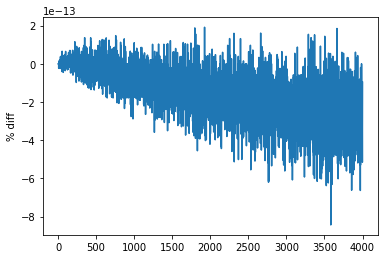

In [81]:
plt.plot((frank_cl - frank_Cl) / frank_Cl *100)
plt.ylabel('% diff');